In [1]:
%load_ext autoreload
%autoreload 2
import os
import numpy as np
from matplotlib import pyplot as plt
from util import *

## Choose sample images

In [2]:
# set global path
PATH = '/home/canliu/ENL_NetDissect/patches_VAE/MIT_ImageRatings'
INDEXFILE = 'MIT_ImageRatings.csv'
IMAGEPATH = 'All_other_MIT_images'
STRIDE = 60
PSIZE = 64

In [3]:
# get natrualness rating
image_to_score = load_index(file_path = PATH, index_path = INDEXFILE)

# clean the list (some images do not exist)
sorted_image_to_score = []
for image in image_to_score:
    image_path = os.path.join(PATH, IMAGEPATH, image)
    if os.path.exists(image_path):
        sorted_image_to_score.append((image_to_score[image], image))
sorted_image_to_score.sort()

In [4]:
urbans = sorted_image_to_score[:100]
natures = sorted_image_to_score[-100:]

(1.25, 'sun_bwvwmesihdjxgbwi.jpg')


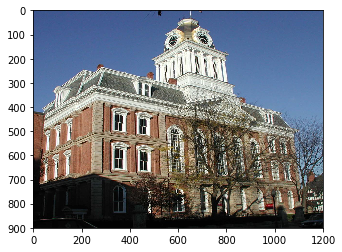

In [7]:
image_name = urbans[99]
print(image_name)
img = plt.imread(os.path.join(PATH, IMAGEPATH, image_name[1]))
plt.imshow(img)

### types of urban images:
1. house (/w grass & sky & trees in countryside)
2. skyscraper (/w sky)
3. city traffic (/w buildings)
4. indoor
5. relics
6. apartments (/w sky in city)

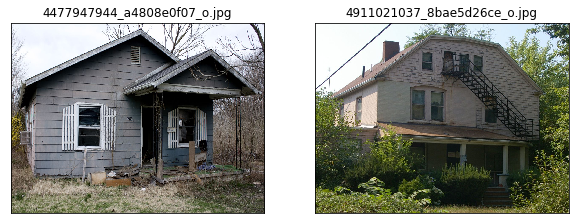

In [128]:
# house 
inds = [1, 56]
fig = plt.figure(figsize = (10, 10))
urban1 = [urbans[i] for i in inds]
for i, img in enumerate(urban1):
    fig.add_subplot(1, 2, i + 1, yticks = [], xticks = [], title = img[1])
    img = plt.imread(os.path.join(PATH, IMAGEPATH, img[1]))
    plt.imshow(img)
plt.show()

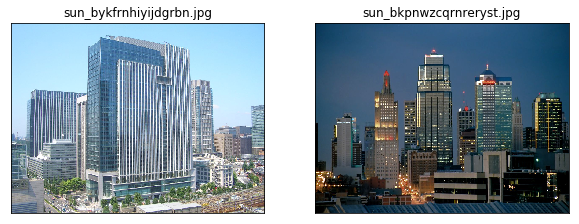

In [140]:
# skyscraper
inds = [20, 81]
fig = plt.figure(figsize = (10, 10))
urban1 = [urbans[i] for i in inds]
for i, img in enumerate(urban1):
    fig.add_subplot(1, 2, i + 1, yticks = [], xticks = [], title = img[1])
    img = plt.imread(os.path.join(PATH, IMAGEPATH, img[1]))
    plt.imshow(img)
plt.show()

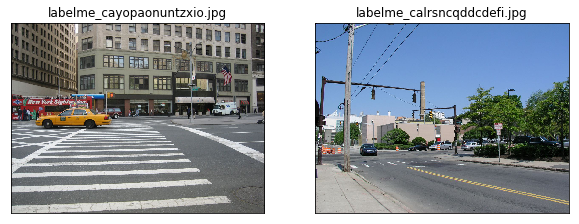

In [146]:
# city traffic
inds = [5, 4]
fig = plt.figure(figsize = (10, 10))
urban1 = [urbans[i] for i in inds]
for i, img in enumerate(urban1):
    fig.add_subplot(1, 2, i + 1, yticks = [], xticks = [], title = img[1])
    img = plt.imread(os.path.join(PATH, IMAGEPATH, img[1]))
    plt.imshow(img)
plt.show()

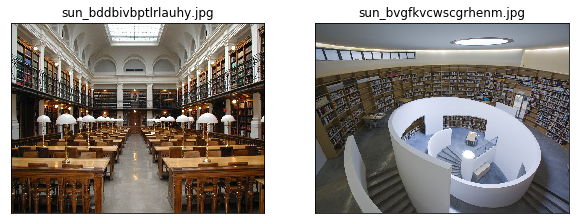

In [148]:
# indoor
inds = [85, 92]
fig = plt.figure(figsize = (10, 10))
urban1 = [urbans[i] for i in inds]
for i, img in enumerate(urban1):
    fig.add_subplot(1, 2, i + 1, yticks = [], xticks = [], title = img[1])
    img = plt.imread(os.path.join(PATH, IMAGEPATH, img[1]))
    plt.imshow(img)
plt.show()

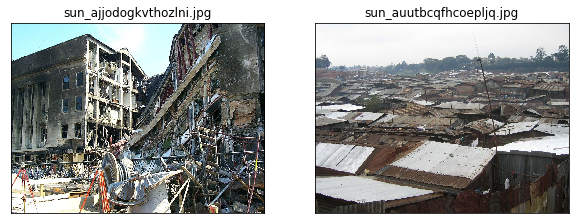

In [150]:
# relics
inds = [64, 96]
fig = plt.figure(figsize = (10, 10))
urban1 = [urbans[i] for i in inds]
for i, img in enumerate(urban1):
    fig.add_subplot(1, 2, i + 1, yticks = [], xticks = [], title = img[1])
    img = plt.imread(os.path.join(PATH, IMAGEPATH, img[1]))
    plt.imshow(img)
plt.show()

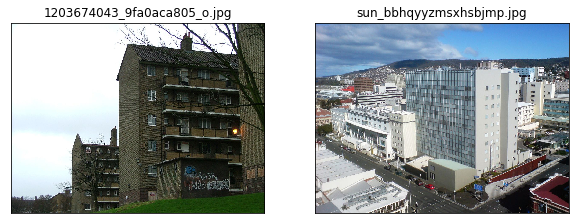

In [153]:
# apartments
inds = [67, 70]
fig = plt.figure(figsize = (10, 10))
urban1 = [urbans[i] for i in inds]
for i, img in enumerate(urban1):
    fig.add_subplot(1, 2, i + 1, yticks = [], xticks = [], title = img[1])
    img = plt.imread(os.path.join(PATH, IMAGEPATH, img[1]))
    plt.imshow(img)
plt.show()

## Randomly Sample Images

In [5]:
# randomly sample 20 from each category
import random

def sample(num_samples):
    urban_random, nature_random = [], []
    while len(urban_random) < num_samples or len(nature_random) < num_samples:
        lu = len(urban_random)
        ln = len(nature_random)
        print("length of urban: {}, length of nature: {}".format(lu, ln))
        for i in range(num_samples - lu):
            urban_random.append(random.randint(0, 100))
        for i in range(num_samples - ln):
            nature_random.append(random.randint(1, 101))
        urban_random = list(set(urban_random))
        nature_random = list(set(nature_random))
    return urban_random, nature_random

In [99]:
urban_random, nature_random = sample(5)
urban_random = [sorted_image_to_score[ind] for ind in urban_random]
nature_random = [sorted_image_to_score[-ind] for ind in nature_random]

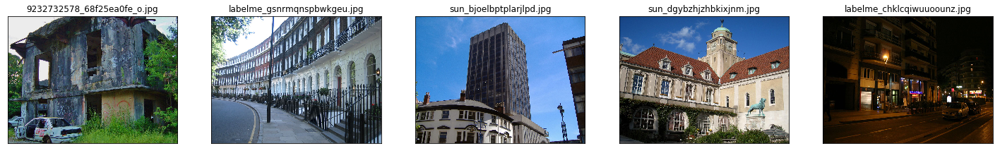

In [100]:
# visualize urban
fig = plt.figure(figsize = (25, 20))
for i, img in enumerate(urban_random):
    fig.add_subplot(4, 5, i + 1, yticks = [], xticks = [], title = img[1])
    img = plt.imread(os.path.join(PATH, IMAGEPATH, img[1]))
    plt.imshow(img)
plt.show()

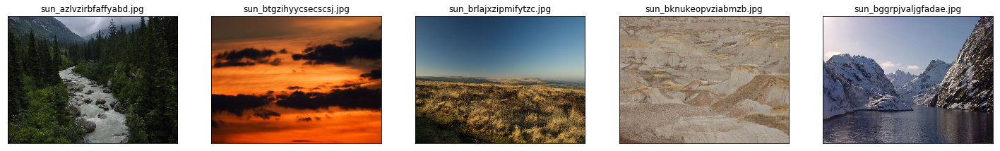

In [101]:
# visualize nature
fig = plt.figure(figsize = (25, 20))
for i, img in enumerate(nature_random):
    fig.add_subplot(4, 5, i + 1, yticks = [], xticks = [], title = img[1])
    img = plt.imread(os.path.join(PATH, IMAGEPATH, img[1]))
    plt.imshow(img)
plt.show()

In [9]:
# run isomap
import pandas as pd
PROW = 19
PCOL = 14
base_dir = '/scratch/midway2/canliu'
GRAM_PATH = os.path.join(base_dir, 'grams')
CLASSES = ['urban', 'neutral', 'nature']
DIMS = {'conv1_1': 64 * 64,
       'pool1': 64 * 64,
       'pool2': 128 * 128,
       'pool3': 256 * 256,
       'pool4': 512 * 512}

In [10]:
def load_gram(handpick = None, gram_path = GRAM_PATH, layer = 'conv1_1', classes = CLASSES, cutoff = None):
    df = []
    idx = 0
    for i, cls in enumerate(classes):
        grams = []
        print("class: {}".format(cls))
        if handpick:
            files = handpick[i]
            files = [os.path.join(gram_path, cls, f[1].split('.')[0] + '.npz') for f in files]
        else:
            files = sorted(glob.glob(os.path.join(gram_path, cls) + "/*"))
        if cutoff:
            files = files[:cutoff]
        for f in files:
            print(f)
            gram = np.load(f)
            for key in gram.keys():
                if key.endswith(layer):
                    layer_gram = gram[key].flatten()
                    grams.append(layer_gram)
        grams_df = pd.DataFrame(grams, index = list(range(idx, idx + len(grams))))
        grams_df['class'] = cls
        df.append(grams_df)
        idx += len(grams)
    return pd.concat(df)

In [106]:
# load data into Pandas DataFrame
layer = 'pool1'
grams_df = load_gram(handpick = [urban_random, nature_random], layer = layer, classes = ['urban', 'nature'])

class: urban
/scratch/midway2/canliu/grams/urban/9232732578_68f25ea0fe_o.npz
/scratch/midway2/canliu/grams/urban/labelme_gsnrmqnspbwkgeu.npz
/scratch/midway2/canliu/grams/urban/sun_bjoelbptplarjlpd.npz
/scratch/midway2/canliu/grams/urban/sun_dgybzhjzhbkixjnm.npz
/scratch/midway2/canliu/grams/urban/labelme_chklcqiwuuoounz.npz
class: nature
/scratch/midway2/canliu/grams/nature/sun_azlvzirbfaffyabd.npz
/scratch/midway2/canliu/grams/nature/sun_btgzihyycsecscsj.npz
/scratch/midway2/canliu/grams/nature/sun_brlajxzipmifytzc.npz
/scratch/midway2/canliu/grams/nature/sun_bknukeopvziabmzb.npz
/scratch/midway2/canliu/grams/nature/sun_bggrpjvaljgfadae.npz


In [107]:
# Normalize the Data (mean = 0, variance = 1)
from sklearn.preprocessing import StandardScaler
x = grams_df.loc[:, list(range(DIMS[layer]))].values # gram matrix ~ features
print(x.shape)
y = grams_df.loc[:, ['class']].values  # class
x = StandardScaler().fit_transform(x) # standardized features

(2660, 4096)


In [13]:
def compute_patches_row_col(ind, num_rol = PROW, num_col = PCOL):
    assert ind < num_rol * num_col
    return (ind // num_col, ind % num_col)

In [109]:
patches = [gen_patches(img[1], file_path = PATH, image_path = IMAGEPATH, stride = STRIDE, psize = PSIZE) for img in urban_random + nature_random] 

### Find the intrinsic dimensionality of the data (if exists)
- compare reconstruction error

In [80]:
# plot clusters with sample patches
def plot(merge_df, patches, title, show_patches = False, method = "Isomap", layer = "pool1", classes = ['urban', 'neutral', 'nature']):
    # merge_df = pd.concat([dfs[dim - 2], grams_df[['class']]], axis = 1)
    fig = plt.figure(figsize = (8,8))
    ax = fig.add_subplot(1,1,1) 
    component1 = 'component 1'
    component2 = 'component 2'
    ax.set_xlabel('{} Component 1'.format(method), fontsize = 15)
    ax.set_ylabel('{} Component 2'.format(method), fontsize = 15)
    ax.set_title(title, fontsize = 20)

    classes = CLASSES[:]
    colors = ['r', 'g', 'b']
    chosen_patches = []
    
    if show_patches:
        x_size = (max(merge_df[component1]) - min(merge_df[component1])) * 0.08
        y_size = (max(merge_df[component2]) - min(merge_df[component2])) * 0.08
        interval = merge_df.shape[0] // 20
        #print("interval: {}".format(interval))
        
        for i in range(20):
            img_num = np.random.randint(i * interval, (i + 1) * interval)
            x0 = merge_df.loc[img_num, component1] - (x_size / 2.)
            y0 = merge_df.loc[img_num, component2] - (y_size / 2.)
            x1 = merge_df.loc[img_num, component1] + (x_size / 2.)
            y1 = merge_df.loc[img_num, component2] + (y_size / 2.)
            img_id, img_num = img_num // (PROW * PCOL), img_num % (PROW * PCOL)
            irow, icol = compute_patches_row_col(img_num)
            #print("img id: {}, irow: {}, icol: {}".format(img_id, irow, icol))
            img = patches[img_id][irow][icol]
            ax.imshow(img, aspect = "auto", interpolation='nearest', zorder = 100000, extent = (x0, x1, y0, y1))
            chosen_patches.append(img)
            
    for cls, color in zip(classes, colors):
        inds = merge_df['class'] == cls
        to_keep = merge_df.loc[inds, component1]
        ax.scatter(merge_df.loc[inds, component1], merge_df.loc[inds, component2], \
                c = color, s = 10)

    ax.legend(classes)
    ax.grid()
    return chosen_patches

### 20 Images from each category:
   - ~1.5 mins training time
   - num_neighbors = 6
   - try for 2 - 10 dimensions
   - intrinsic dimensionality seems to be 4-5

In [19]:
# run isomap
from sklearn import manifold 
import time
costs = []
components_dfs = []
for i in range(2, 11):
    start_time = time.time()
    IM = manifold.Isomap(n_neighbors=6, n_components=i, n_jobs=-1)
    components = IM.fit_transform(x)
    cost = IM.reconstruction_error()
    print("dimension: {}, cost: {}".format(i, cost))
    end_time = time.time()
    costs.append(cost)
    components_df = pd.DataFrame(data = components[:, :2], columns = ["dim {} component 1".format(i), 'dim {} component 2'.format(i)])
    components_dfs.append(components_df)
    print("time costs: {}".format(end_time - start_time))

dimension: 2, cost: 3322.3049894176092
time costs: 89.16857624053955
dimension: 3, cost: 2710.34493020476
time costs: 89.35838484764099
dimension: 4, cost: 2201.682393490785
time costs: 96.48099851608276
dimension: 5, cost: 2023.3634162050437
time costs: 97.49462223052979
dimension: 6, cost: 1889.9882854249693
time costs: 95.57062768936157
dimension: 7, cost: 1811.9692500447347
time costs: 97.15195941925049
dimension: 8, cost: 1750.865593110241
time costs: 94.73407506942749
dimension: 9, cost: 1707.3329799537134
time costs: 95.9786970615387
dimension: 10, cost: 1676.8318601770277
time costs: 128.9745991230011


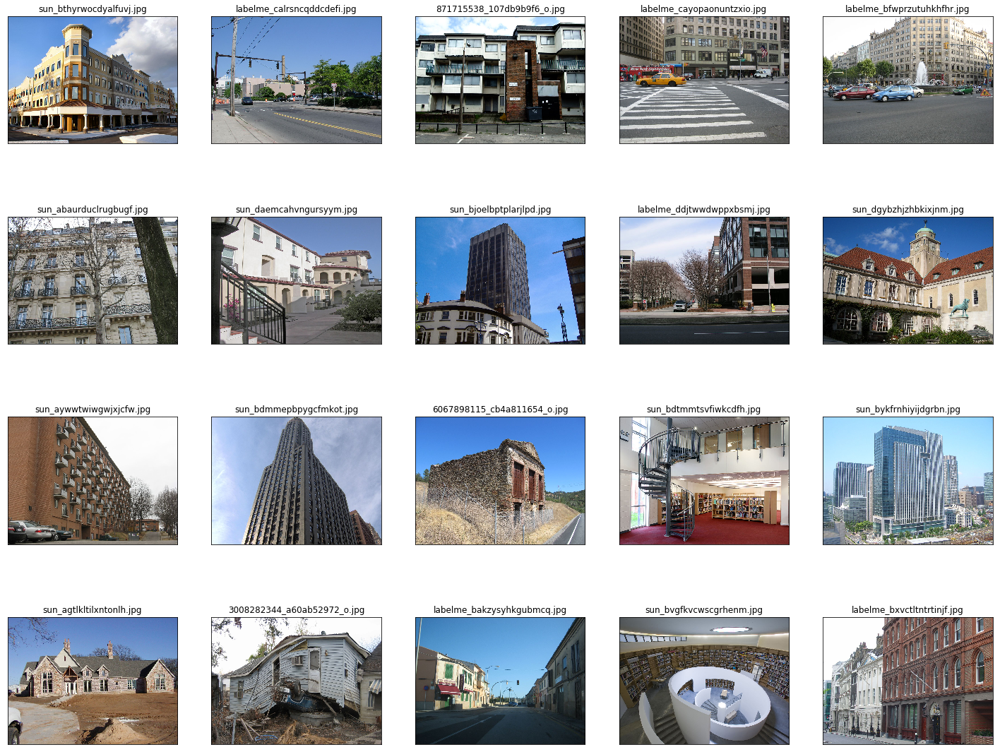

In [20]:
# urban
fig = plt.figure(figsize = (25, 20))
for i, img in enumerate(urban_random):
    fig.add_subplot(4, 5, i + 1, yticks = [], xticks = [], title = img[1])
    img = plt.imread(os.path.join(PATH, IMAGEPATH, img[1]))
    plt.imshow(img)
plt.show()

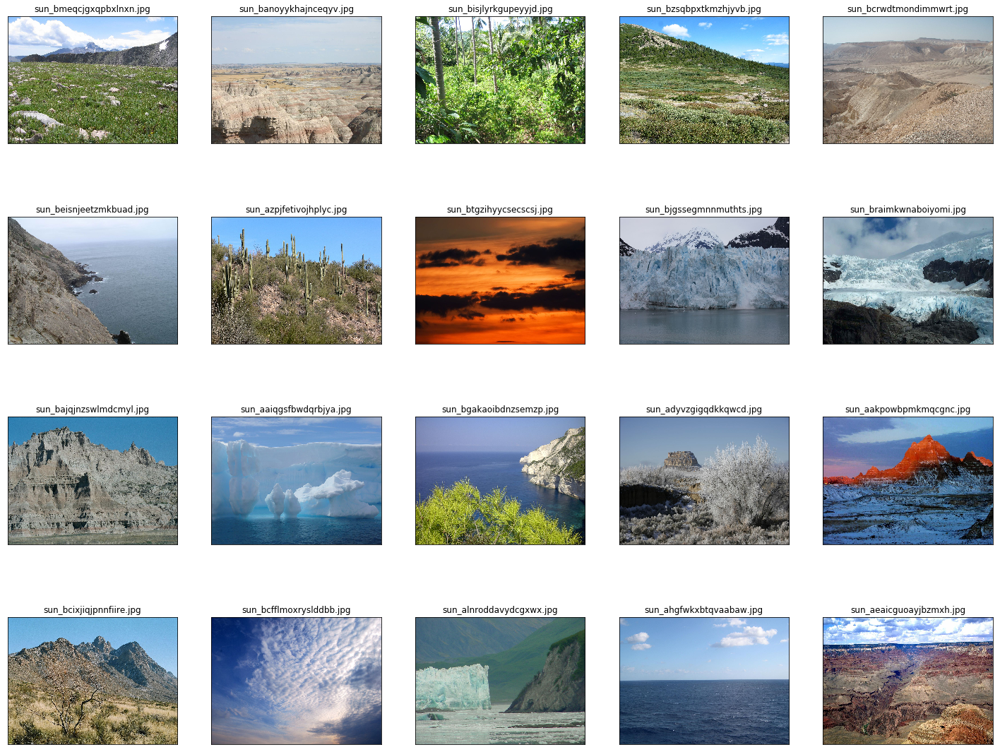

In [11]:
# nature
fig = plt.figure(figsize = (25, 20))
for i, img in enumerate(nature_random):
    fig.add_subplot(4, 5, i + 1, yticks = [], xticks = [], title = img[1])
    img = plt.imread(os.path.join(PATH, IMAGEPATH, img[1]))
    plt.imshow(img)
plt.show()

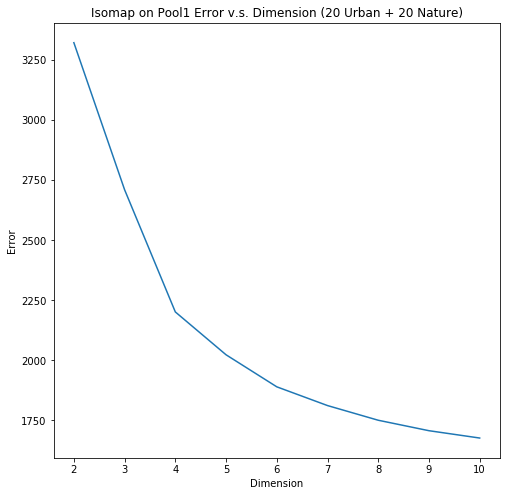

In [29]:
fig = plt.figure(figsize = (8, 8))
fig.add_subplot(1, 1, 1)
plt.plot(costs)
plt.xticks(list(range(9)), list(range(2, 11)))
plt.title("Isomap on Pool1 Error v.s. Dimension (20 Urban + 20 Nature)")
plt.xlabel("Dimension")
plt.ylabel("Error")
plt.show()

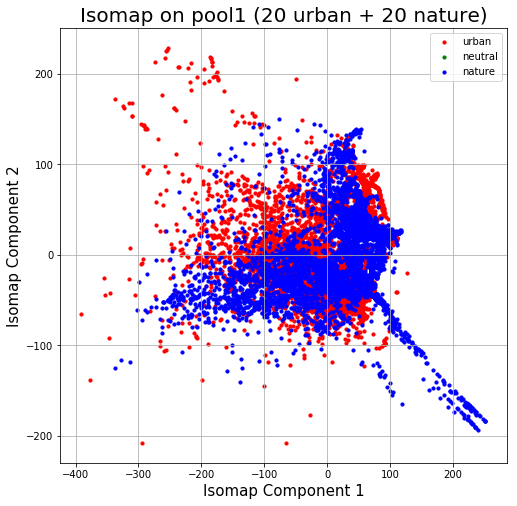

In [62]:
plot(components_dfs, patches, dim = 2, num = 20)

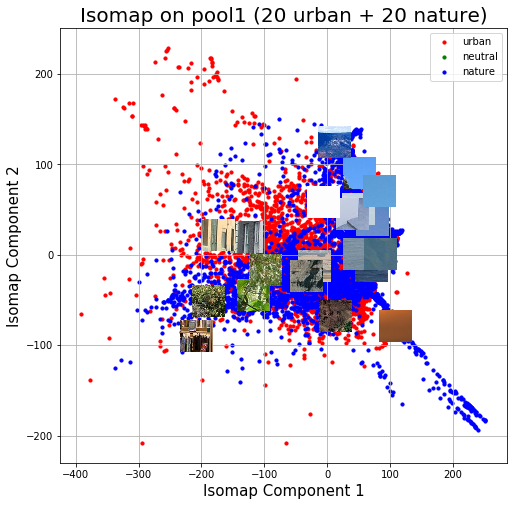

In [91]:
plot(components_dfs, patches, dim = 2, num = 20, show_patches = True)

### 5 images from each category 
- check on different combinations of dimension & neighborhoods
- ~6 secs training time
- number of neighbor increases == error decreases
- first two components are stable

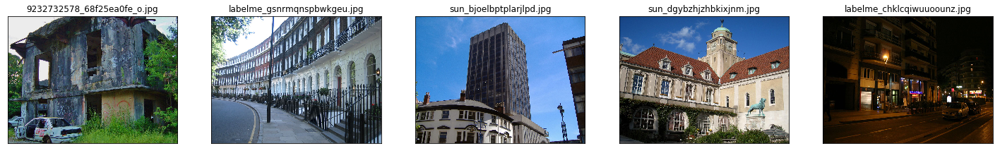

In [102]:
# visualize urban
fig = plt.figure(figsize = (25, 20))
for i, img in enumerate(urban_random):
    fig.add_subplot(4, 5, i + 1, yticks = [], xticks = [], title = img[1])
    img = plt.imread(os.path.join(PATH, IMAGEPATH, img[1]))
    plt.imshow(img)
plt.show()

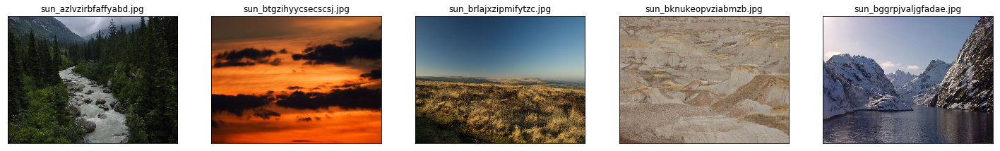

In [103]:
# visualize urban
fig = plt.figure(figsize = (25, 20))
for i, img in enumerate(nature_random):
    fig.add_subplot(4, 5, i + 1, yticks = [], xticks = [], title = img[1])
    img = plt.imread(os.path.join(PATH, IMAGEPATH, img[1]))
    plt.imshow(img)
plt.show()

In [113]:
# run isomap
from sklearn import manifold 
import time
results = dict()
for neighbor in [5, 7, 9, 11]:
    results[neighbor] = {}
    costs = []
    for dim in range(2, 16):
        start_time = time.time()
        IM = manifold.Isomap(n_neighbors=neighbor, n_components=dim, n_jobs=-1)
        components = IM.fit_transform(x)
        cost = IM.reconstruction_error()
        print("dimension: {}, cost: {}".format(dim, cost))
        end_time = time.time()
        costs.append(cost)
        if dim == 2:
            components_df = pd.DataFrame(data = components, columns = ["component 1", 'component 2'])
        print("time costs: {}".format(end_time - start_time))
    results[neighbor]['costs'] = costs
    results[neighbor]['components'] = components_df

dimension: 2, cost: 3189.089524111342
time costs: 5.378028631210327
dimension: 3, cost: 2586.4009181479264
time costs: 5.235318660736084
dimension: 4, cost: 2246.4333863726906
time costs: 5.187975168228149
dimension: 5, cost: 2060.406411070486
time costs: 5.1925272941589355
dimension: 6, cost: 1935.6182519471129
time costs: 5.037378787994385
dimension: 7, cost: 1818.4871439898996
time costs: 5.21613883972168
dimension: 8, cost: 1712.8198432605404
time costs: 5.2669336795806885
dimension: 9, cost: 1633.9697460445475
time costs: 5.143742561340332
dimension: 10, cost: 1562.5062845556015
time costs: 5.542144298553467
dimension: 11, cost: 1509.3530608369983
time costs: 5.7448060512542725
dimension: 12, cost: 1479.947964772468
time costs: 5.879384517669678
dimension: 13, cost: 1455.1918992585333
time costs: 5.673276662826538
dimension: 14, cost: 1438.5555351983746
time costs: 5.675339698791504
dimension: 15, cost: 1427.0121764634293
time costs: 5.799872398376465
dimension: 2, cost: 2362.9016

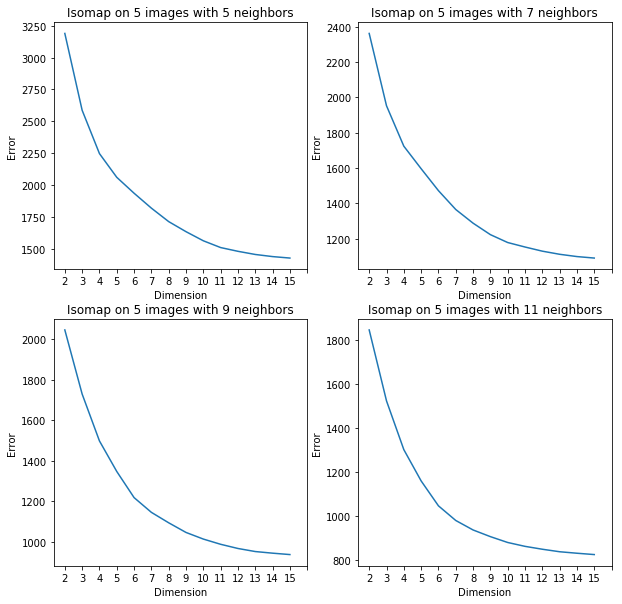

In [114]:
# plot dimension v.s. error 
fig = plt.figure(figsize = (10, 10))
for i, neighbor in enumerate(results):
    costs = results[neighbor]['costs']
    fig.add_subplot(2, 2, i + 1, title = "Isomap on 5 images with {} neighbors".format(neighbor), xlabel = "Dimension", ylabel = "Error")
    plt.plot(costs)
    plt.xticks(list(range(15)), list(range(2, 16)))
plt.show()

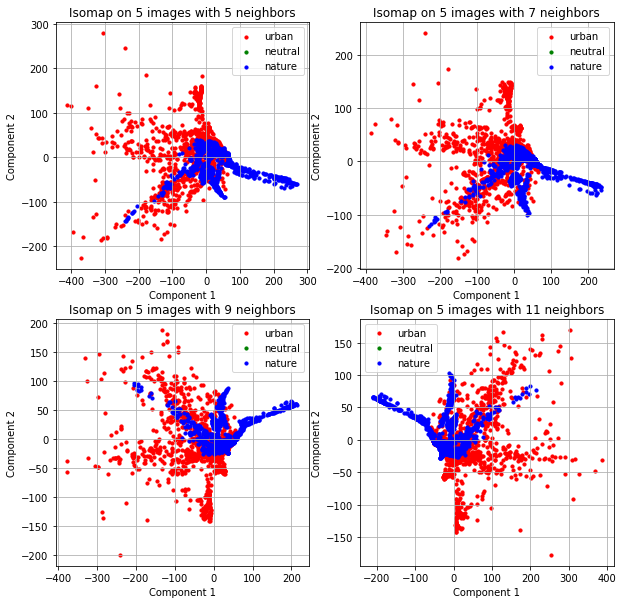

In [116]:
# plot components
fig = plt.figure(figsize = (10, 10))
for i, neighbor in enumerate(results):
    ax = fig.add_subplot(2, 2, i + 1, title = "Isomap on 5 images with {} neighbors".format(neighbor), xlabel = "Component 1", ylabel = "Component 2")
    components_df = results[neighbor]['components']
    merge_df = pd.concat([components_df, grams_df[['class']]], axis = 1)

    classes = ['urban', 'neutral', 'nature']
    colors = ['r', 'g', 'b']

    for cls, color in zip(classes, colors):
        inds = merge_df['class'] == cls
        to_keep = merge_df.loc[inds, 'component 1']
        ax.scatter(merge_df.loc[inds, 'component 1'], merge_df.loc[inds, 'component 2'], \
                c = color, s = 10)
    
    ax.legend(classes)
    ax.grid()
plt.show()

In [ ]:
# visualize patches
components_df = results[11]['components']
merge_df = pd.concat([components_df, grams_df[['class']]], axis = 1)
plot(merge_df, patches, num = 5, show_patches = True)

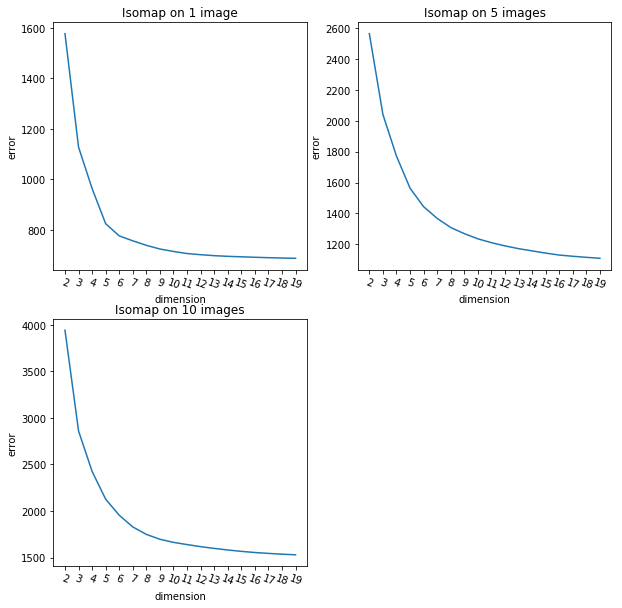

In [110]:
fig = plt.figure(figsize = (10, 10))
fig.add_subplot(2, 2, 1, title = "Isomap on 1 image", xlabel = "dimension", ylabel = "error")
plt.xticks(list(range(19)), list(range(2, 20)), rotation = -20)
plt.plot(costs_1)
fig.add_subplot(2, 2, 2, title = "Isomap on 5 images", xlabel = "dimension", ylabel = "error")
plt.xticks(list(range(19)), list(range(2, 20)), rotation = -20)
plt.plot(costs_5)
fig.add_subplot(2, 2, 3, title = "Isomap on 10 images", xlabel = "dimension", ylabel = "error")
plt.xticks(list(range(19)), list(range(2, 20)), rotation = -20)
plt.plot(costs_10)

### Run on different sampling
- number of neighbors: 7
- dimension: 2

In [101]:
random.seed(2)
urban_random, nature_random = sample(20)
urban_random = [sorted_image_to_score[ind] for ind in urban_random]
nature_random = [sorted_image_to_score[-ind] for ind in nature_random]

length of urban: 0, length of nature: 0
length of urban: 19, length of nature: 19


#### Sampling 1

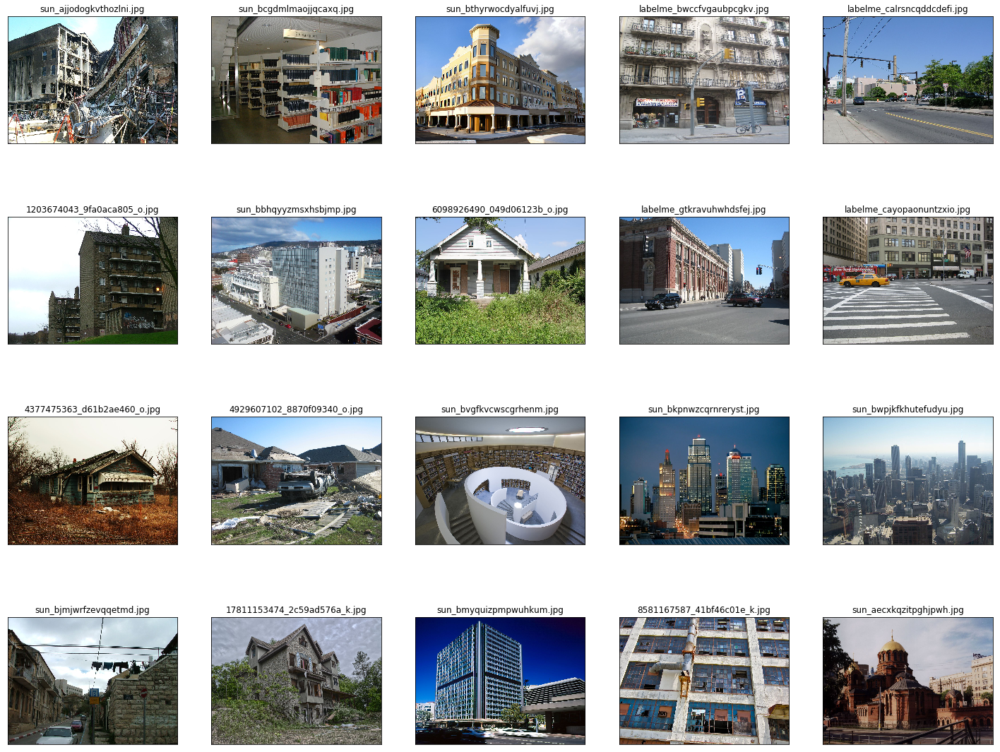

In [7]:
# visualize urban
fig = plt.figure(figsize = (25, 20))
for i, img in enumerate(urban_random):
    fig.add_subplot(4, 5, i + 1, yticks = [], xticks = [], title = img[1])
    img = plt.imread(os.path.join(PATH, IMAGEPATH, img[1]))
    plt.imshow(img)
plt.show()

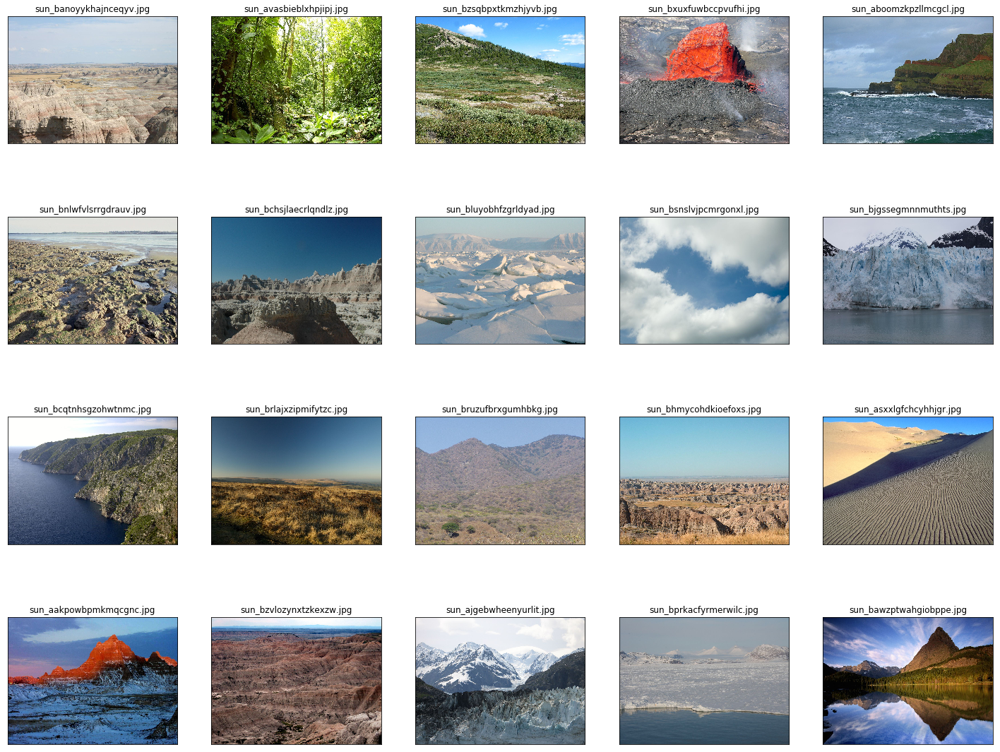

In [8]:
# visualize urban
fig = plt.figure(figsize = (25, 20))
for i, img in enumerate(nature_random):
    fig.add_subplot(4, 5, i + 1, yticks = [], xticks = [], title = img[1])
    img = plt.imread(os.path.join(PATH, IMAGEPATH, img[1]))
    plt.imshow(img)
plt.show()

#### Sampling 2 - seed = 1

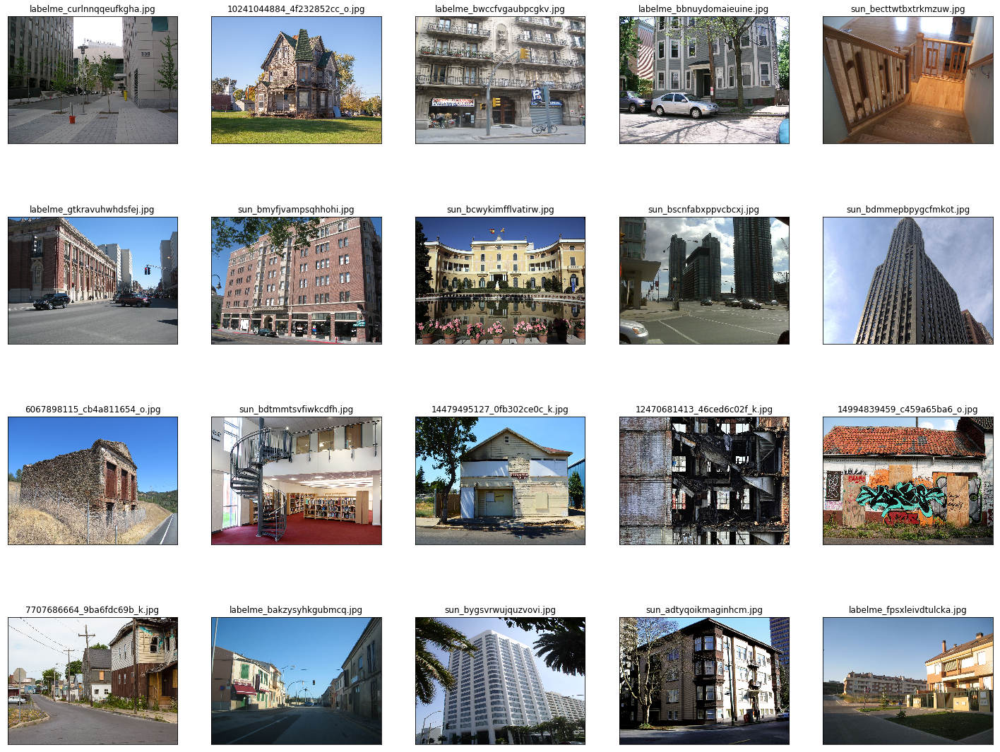

In [88]:
# visualize urban
fig = plt.figure(figsize = (25, 20))
for i, img in enumerate(urban_random):
    fig.add_subplot(4, 5, i + 1, yticks = [], xticks = [], title = img[1])
    img = plt.imread(os.path.join(PATH, IMAGEPATH, img[1]))
    plt.imshow(img)
plt.show()

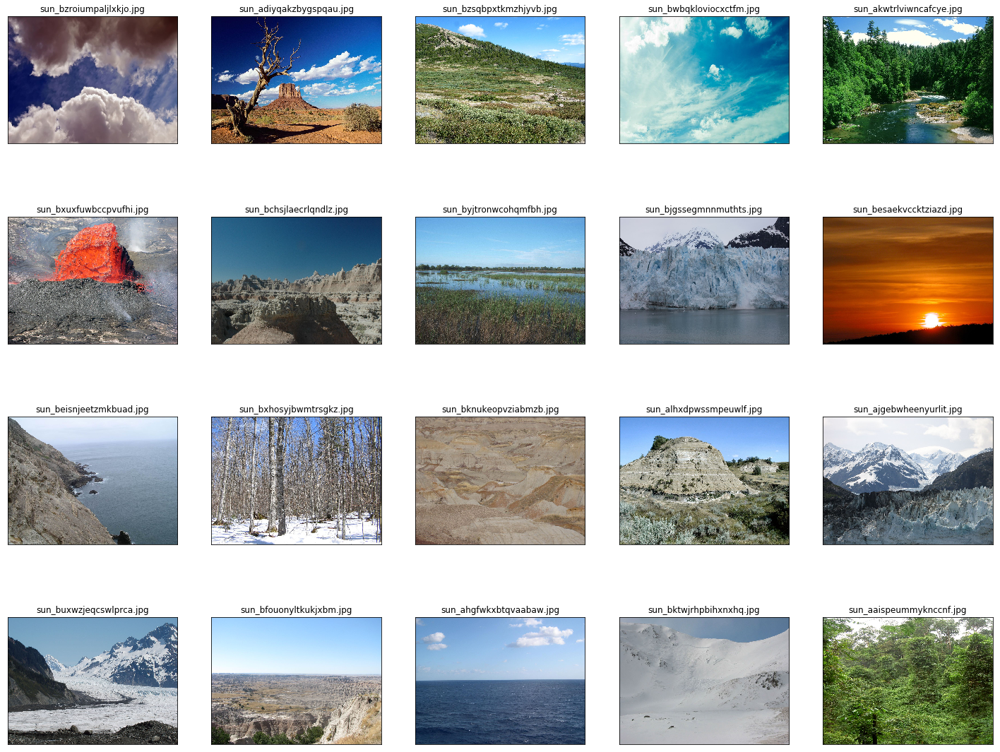

In [89]:
# visualize urban
fig = plt.figure(figsize = (25, 20))
for i, img in enumerate(nature_random):
    fig.add_subplot(4, 5, i + 1, yticks = [], xticks = [], title = img[1])
    img = plt.imread(os.path.join(PATH, IMAGEPATH, img[1]))
    plt.imshow(img)
plt.show()

#### Sampling 3 - seed = 2

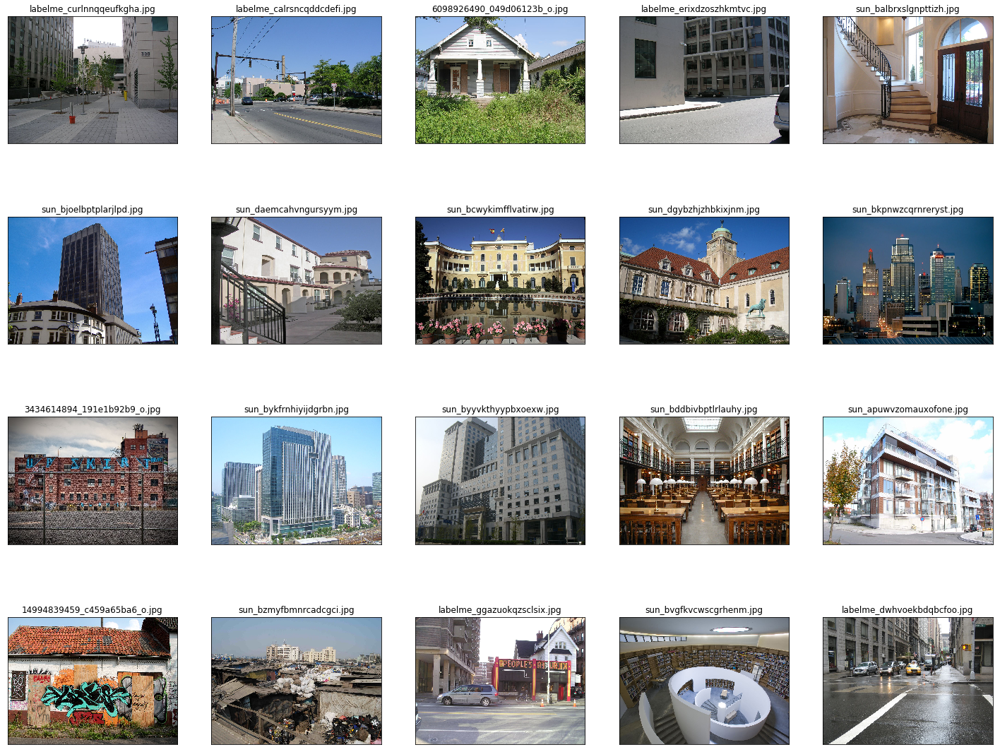

In [102]:
# visualize urban
fig = plt.figure(figsize = (25, 20))
for i, img in enumerate(urban_random):
    fig.add_subplot(4, 5, i + 1, yticks = [], xticks = [], title = img[1])
    img = plt.imread(os.path.join(PATH, IMAGEPATH, img[1]))
    plt.imshow(img)
plt.show()

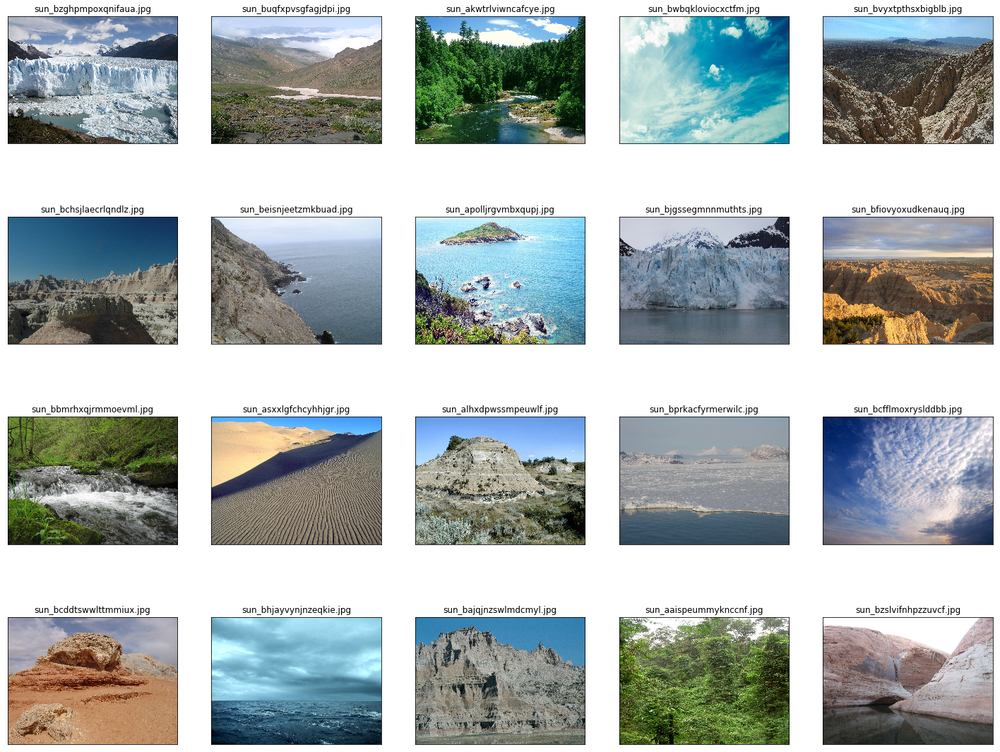

In [104]:
# visualize urban
fig = plt.figure(figsize = (25, 20))
for i, img in enumerate(nature_random):
    fig.add_subplot(4, 5, i + 1, yticks = [], xticks = [], title = img[1])
    img = plt.imread(os.path.join(PATH, IMAGEPATH, img[1]))
    plt.imshow(img)
plt.show()

In [105]:
# load data into Pandas DataFrame
layer = 'pool1'
grams_df = load_gram(handpick = [urban_random, nature_random], layer = layer, classes = ['urban', 'nature'])

class: urban
/scratch/midway2/canliu/grams/urban/labelme_curlnnqqeufkgha.npz
/scratch/midway2/canliu/grams/urban/labelme_calrsncqddcdefi.npz
/scratch/midway2/canliu/grams/urban/6098926490_049d06123b_o.npz
/scratch/midway2/canliu/grams/urban/labelme_erixdzoszhkmtvc.npz
/scratch/midway2/canliu/grams/urban/sun_balbrxslgnpttizh.npz
/scratch/midway2/canliu/grams/urban/sun_bjoelbptplarjlpd.npz
/scratch/midway2/canliu/grams/urban/sun_daemcahvngursyym.npz
/scratch/midway2/canliu/grams/urban/sun_bcwykimfflvatirw.npz
/scratch/midway2/canliu/grams/urban/sun_dgybzhjzhbkixjnm.npz
/scratch/midway2/canliu/grams/urban/sun_bkpnwzcqrnreryst.npz
/scratch/midway2/canliu/grams/urban/3434614894_191e1b92b9_o.npz
/scratch/midway2/canliu/grams/urban/sun_bykfrnhiyijdgrbn.npz
/scratch/midway2/canliu/grams/urban/sun_byyvkthyypbxoexw.npz
/scratch/midway2/canliu/grams/urban/sun_bddbivbptlrlauhy.npz
/scratch/midway2/canliu/grams/urban/sun_apuwvzomauxofone.npz
/scratch/midway2/canliu/grams/urban/14994839459_c459a65ba

In [106]:
# Normalize the Data (mean = 0, variance = 1)
from sklearn.preprocessing import StandardScaler
x = grams_df.loc[:, list(range(DIMS[layer]))].values # gram matrix ~ features
print(x.shape)
y = grams_df.loc[:, ['class']].values  # class
x = StandardScaler().fit_transform(x) # standardized features

(10640, 4096)


In [107]:
patches = [gen_patches(img[1], file_path = PATH, image_path = IMAGEPATH, stride = STRIDE, psize = PSIZE) for img in urban_random + nature_random] 

In [108]:
from sklearn import manifold 
IM = manifold.Isomap(n_neighbors=7, n_components=2, n_jobs=-1)
components = IM.fit_transform(x)
components_df = pd.DataFrame(data = components, columns = ["component 1", 'component 2'])
merge_df = pd.concat([components_df, grams_df[['class']]], axis = 1)

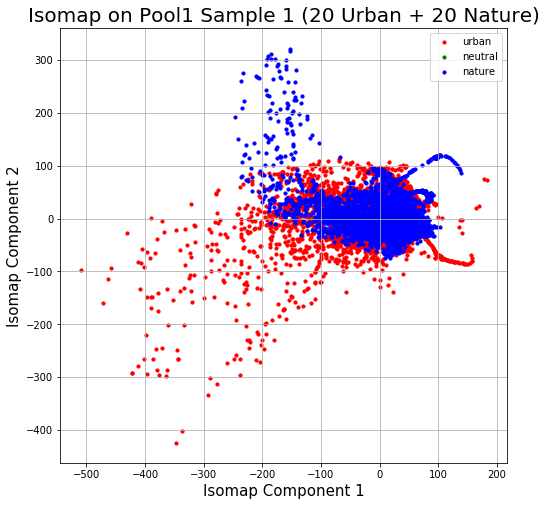

In [19]:
plot(merge_df, patches, title = "Isomap on Pool1 Sample 1 (20 Urban + 20 Nature)")

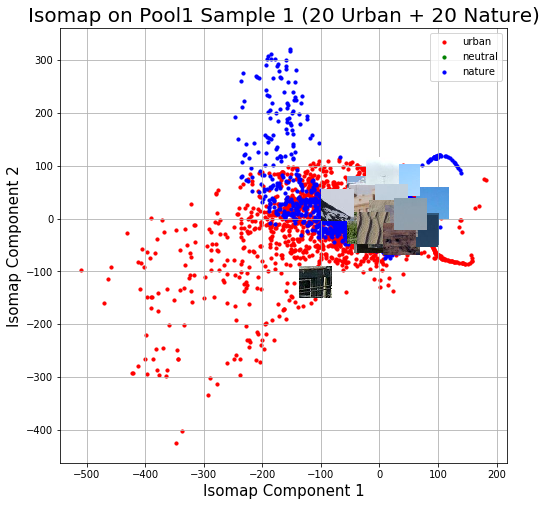

In [81]:
chosen_patches = plot(merge_df, patches, title = "Isomap on Pool1 Sample 1 (20 Urban + 20 Nature)", show_patches = True)

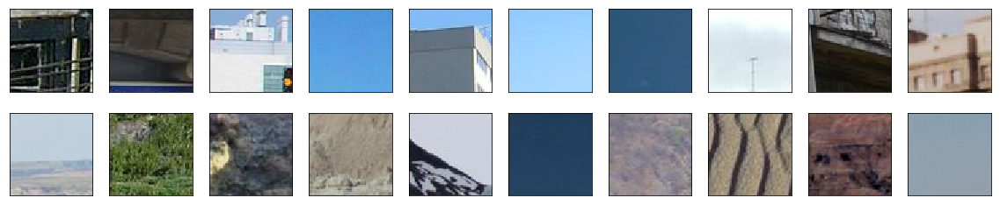

In [82]:
# chosen patches
fig = plt.figure(figsize = (20, 4))
for i, patch in enumerate(chosen_patches):
    fig.add_subplot(2, 10, i + 1, yticks = [], xticks = [])
    plt.imshow(patch)
plt.show()

[]

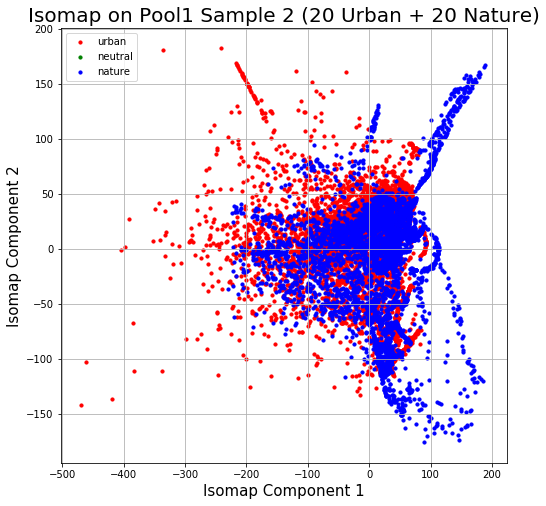

In [94]:
plot(merge_df, patches, title = "Isomap on Pool1 Sample 2 (20 Urban + 20 Nature)")

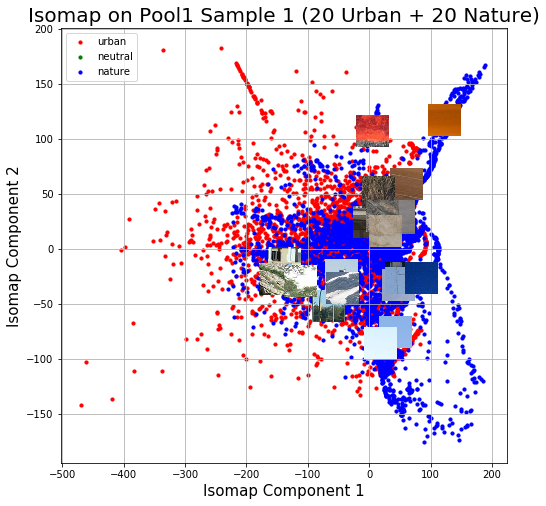

In [99]:
chosen_patches = plot(merge_df, patches, title = "Isomap on Pool1 Sample 1 (20 Urban + 20 Nature)", show_patches = True)

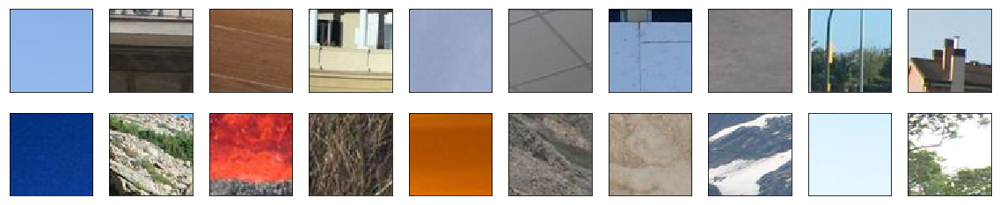

In [100]:
# chosen patches
fig = plt.figure(figsize = (20, 4))
for i, patch in enumerate(chosen_patches):
    fig.add_subplot(2, 10, i + 1, yticks = [], xticks = [])
    plt.imshow(patch)
plt.show()

[]

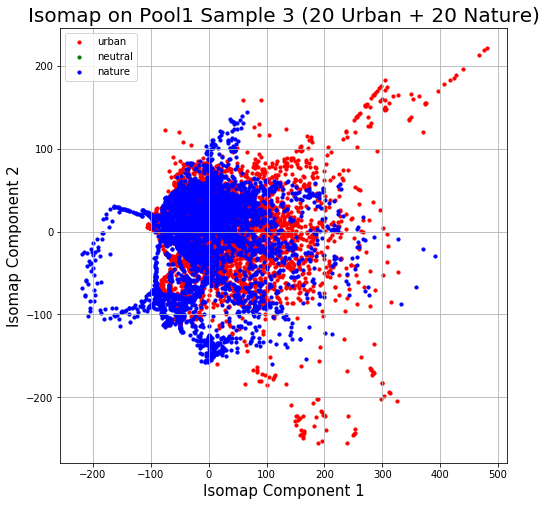

In [109]:
plot(merge_df, patches, title = "Isomap on Pool1 Sample 3 (20 Urban + 20 Nature)")

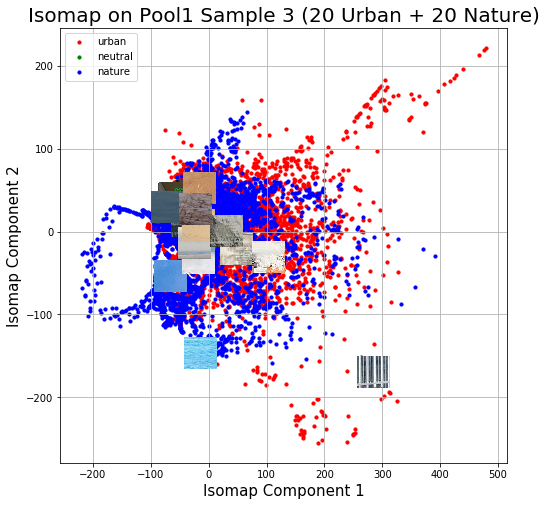

In [110]:
chosen_patches = plot(merge_df, patches, title = "Isomap on Pool1 Sample 3 (20 Urban + 20 Nature)", show_patches = True)

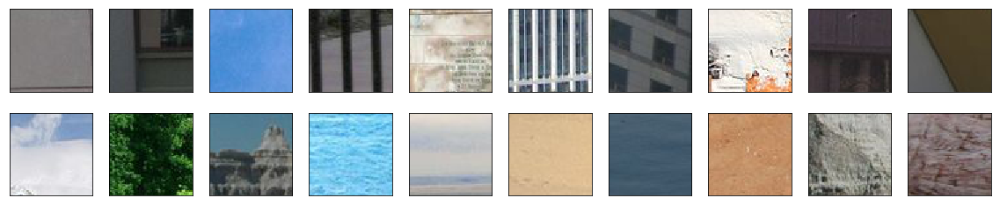

In [111]:
# chosen patches
fig = plt.figure(figsize = (20, 4))
for i, patch in enumerate(chosen_patches):
    fig.add_subplot(2, 10, i + 1, yticks = [], xticks = [])
    plt.imshow(patch)
plt.show()

In [112]:
IM.reconstruction_error()

2931.148684851029

### Use extracted features for classification
- unsupervised: kmeans
- supservised: SVM (20 for training, 20 for testing)

In [113]:
random.seed(20090930)
urban_random, nature_random = sample(20)
urban_random = [sorted_image_to_score[ind] for ind in urban_random]
nature_random = [sorted_image_to_score[-ind] for ind in nature_random]

length of urban: 0, length of nature: 0
length of urban: 18, length of nature: 19


#### Unsupervised

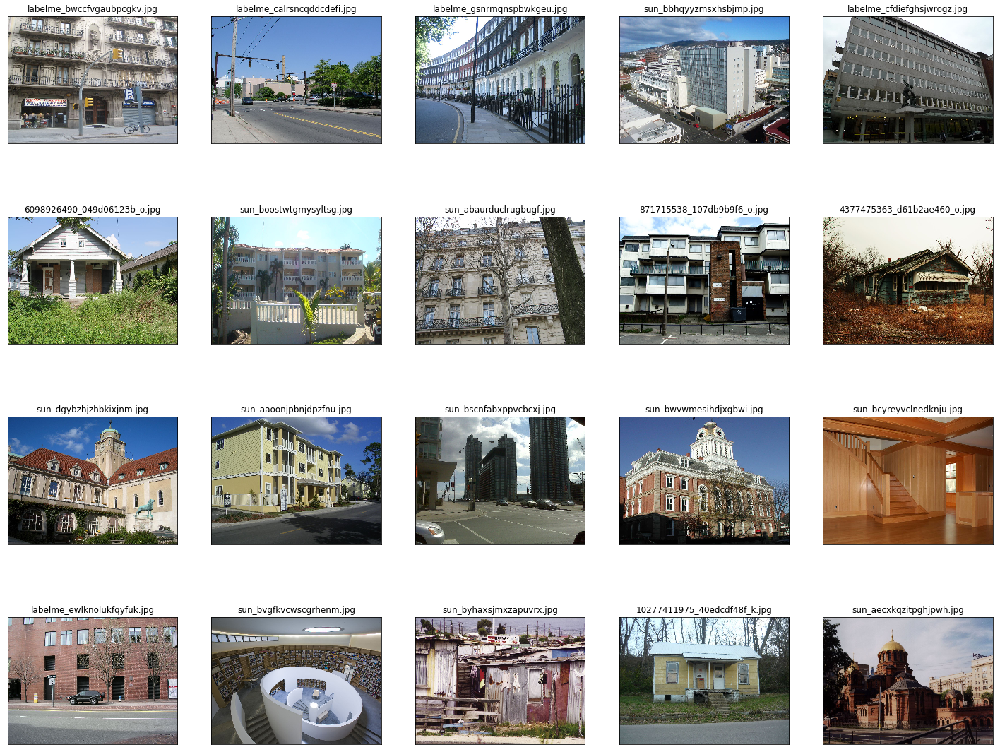

In [114]:
# visualize urban - seed = 20090930
fig = plt.figure(figsize = (25, 20))
for i, img in enumerate(urban_random):
    fig.add_subplot(4, 5, i + 1, yticks = [], xticks = [], title = img[1])
    img = plt.imread(os.path.join(PATH, IMAGEPATH, img[1]))
    plt.imshow(img)
plt.show()

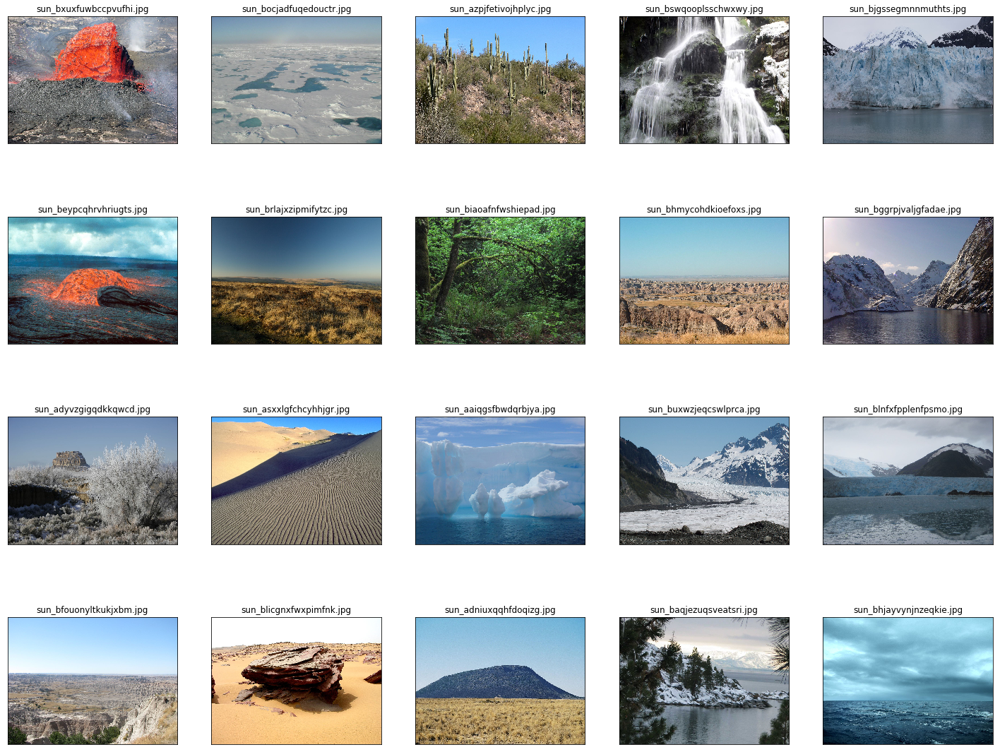

In [115]:
# visualize nature
fig = plt.figure(figsize = (25, 20))
for i, img in enumerate(nature_random):
    fig.add_subplot(4, 5, i + 1, yticks = [], xticks = [], title = img[1])
    img = plt.imread(os.path.join(PATH, IMAGEPATH, img[1]))
    plt.imshow(img)
plt.show()

In [116]:
# load data into Pandas DataFrame
layer = 'pool1'
grams_df = load_gram(handpick = [urban_random, nature_random], layer = layer, classes = ['urban', 'nature'])

# Normalize the Data (mean = 0, variance = 1)
from sklearn.preprocessing import StandardScaler
x = grams_df.loc[:, list(range(DIMS[layer]))].values # gram matrix ~ features
print(x.shape)
y = grams_df.loc[:, ['class']].values  # class
x = StandardScaler().fit_transform(x) # standardized features

class: urban
/scratch/midway2/canliu/grams/urban/labelme_bwccfvgaubpcgkv.npz
/scratch/midway2/canliu/grams/urban/labelme_calrsncqddcdefi.npz
/scratch/midway2/canliu/grams/urban/labelme_gsnrmqnspbwkgeu.npz
/scratch/midway2/canliu/grams/urban/sun_bbhqyyzmsxhsbjmp.npz
/scratch/midway2/canliu/grams/urban/labelme_cfdiefghsjwrogz.npz
/scratch/midway2/canliu/grams/urban/6098926490_049d06123b_o.npz
/scratch/midway2/canliu/grams/urban/sun_boostwtgmysyltsg.npz
/scratch/midway2/canliu/grams/urban/sun_abaurduclrugbugf.npz
/scratch/midway2/canliu/grams/urban/871715538_107db9b9f6_o.npz
/scratch/midway2/canliu/grams/urban/4377475363_d61b2ae460_o.npz
/scratch/midway2/canliu/grams/urban/sun_dgybzhjzhbkixjnm.npz
/scratch/midway2/canliu/grams/urban/sun_aaoonjpbnjdpzfnu.npz
/scratch/midway2/canliu/grams/urban/sun_bscnfabxppvcbcxj.npz
/scratch/midway2/canliu/grams/urban/sun_bwvwmesihdjxgbwi.npz
/scratch/midway2/canliu/grams/urban/sun_bcyreyvclnedknju.npz
/scratch/midway2/canliu/grams/urban/labelme_ewlknolu

In [117]:
# prepare patches
patches = [gen_patches(img[1], file_path = PATH, image_path = IMAGEPATH, stride = STRIDE, psize = PSIZE) for img in urban_random + nature_random] 

In [118]:
# extract features
from sklearn import manifold 
IM = manifold.Isomap(n_neighbors=7, n_components=6, n_jobs=-1)
components = IM.fit_transform(x)
components_df = pd.DataFrame(data = components[:, :2], columns = ["component 1", 'component 2'])
merge_df = pd.concat([components_df, grams_df[['class']]], axis = 1)

[]

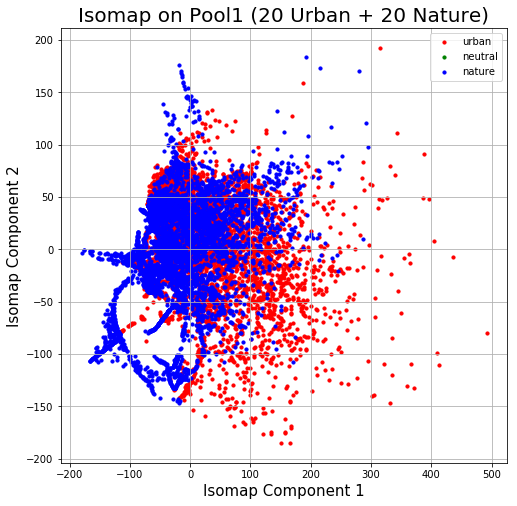

In [119]:
plot(merge_df, patches, title = "Isomap on Pool1 (20 Urban + 20 Nature)")

In [154]:
num_split = components.shape[0] // 2
labels = np.concatenate([np.ones(num_split), np.zeros(num_split)]).astype(int)

In [141]:
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=2, random_state=0)
prediction = kmeans.fit_predict(components)

In [155]:
merge_df['prediction'] = prediction
merge_df['labels'] = labels

In [163]:
correct = merge_df['prediction'] == merge_df['labels']
wrong = merge_df['prediction'] != merge_df['labels']

In [164]:
correct_df = merge_df.loc[correct]
wrong_df = merge_df[wrong]

In [162]:
# check correctness - slightly better than random guessing
correct_count = correct_df.shape[0]
print("correctness: {}%".format(correct_count / components.shape[0] * 100))

correctness: 59.02255639097744%


In [206]:
# confusion matrix for urban
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(merge_df['prediction'], merge_df['labels'])

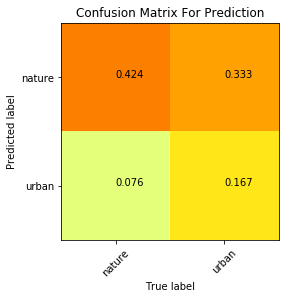

In [223]:
# or the other way around
plt.clf()
classNames = ['nature', 'urban']
plt.imshow(cm, interpolation='nearest', cmap = plt.cm.Wistia)
tick_marks = np.arange(len(classNames))
plt.title("Confusion Matrix For Prediction")
plt.ylabel('Predicted label')
plt.xlabel('True label')
plt.xticks(tick_marks, classNames, rotation=45)
plt.yticks(tick_marks, classNames)
for i in range(2):
    for j in range(2):
        plt.text(j,i, round(cm[i][j] / components.shape[0], 3))

In [203]:
correct_urban = correct_df[correct_df['class'] == 'urban']
correct_nature = correct_df[correct_df['class'] == 'nature']
print("correctness for urban: {}%".format(correct_urban.shape[0] / num_split * 100))
print("correctness for nature: {}%".format(correct_nature.shape[0] / num_split * 100))

correctness for urban: 33.308270676691734%
correctness for nature: 84.73684210526315%


In [178]:
index_to_class = {0: 'nature', 1: 'urban'}

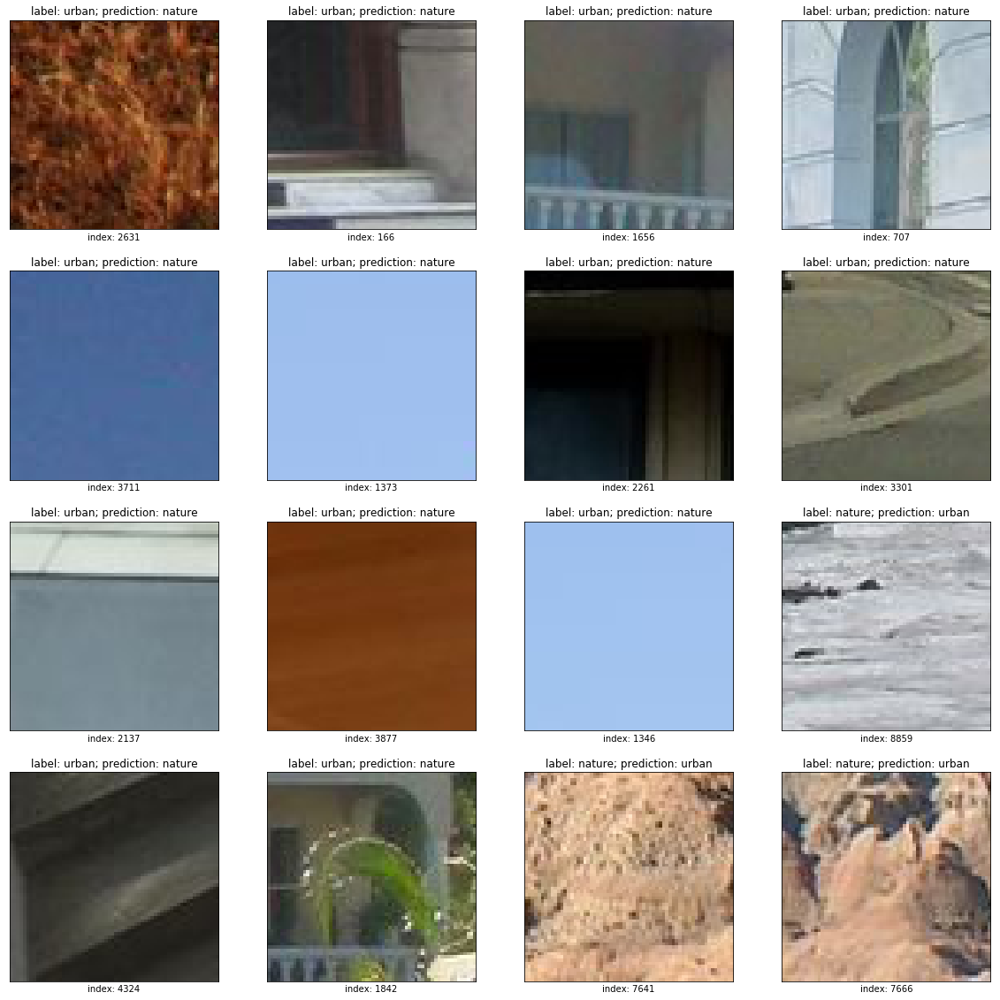

In [194]:
# some misclassification
wrong_indices = wrong_df.index.tolist()
img_nums = random.sample(wrong_indices, 16)
fig = plt.figure(figsize = (20, 20))
for i, raw_img_num in enumerate(img_nums):
    row = merge_df.iloc[raw_img_num]
    img_id, img_num = raw_img_num // (PROW * PCOL), raw_img_num % (PROW * PCOL)
    irow, icol = compute_patches_row_col(img_num)
    patch = patches[img_id][irow][icol]
    fig.add_subplot(4, 4, i + 1, xticks = [], yticks = [], xlabel = "index: {}".format(raw_img_num), \
                    title = 'label: {}; prediction: {}'.format(row['class'], index_to_class[row['prediction']]))
    plt.imshow(patch)

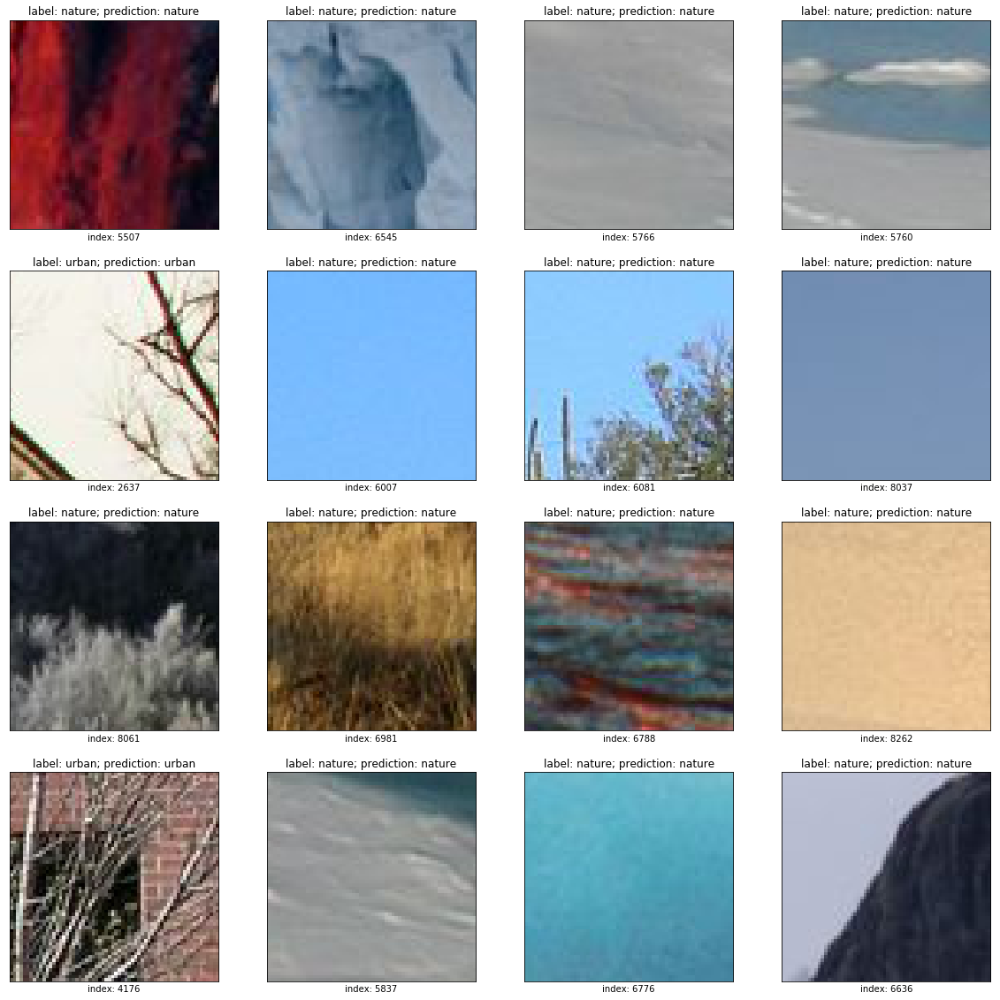

In [197]:
# some correct classification
correct_indices = correct_df.index.tolist()
correct_img_nums = random.sample(correct_indices, 16)
fig = plt.figure(figsize = (20, 20))
for i, raw_img_num in enumerate(correct_img_nums):
    row = merge_df.iloc[raw_img_num]
    img_id, img_num = raw_img_num // (PROW * PCOL), raw_img_num % (PROW * PCOL)
    irow, icol = compute_patches_row_col(img_num)
    patch = patches[img_id][irow][icol]
    fig.add_subplot(4, 4, i + 1, xticks = [], yticks = [], xlabel = "index: {}".format(raw_img_num), \
                    title = 'label: {}; prediction: {}'.format(row['class'], index_to_class[row['prediction']]))
    plt.imshow(patch)

#### Supervised Learning

With Linear Kernel

In [225]:
from sklearn.svm import LinearSVC
clf = LinearSVC(random_state=0, tol=1e-5)

In [226]:
clf.fit(components, merge_df['labels'])

LinearSVC(C=1.0, class_weight=None, dual=True, fit_intercept=True,
     intercept_scaling=1, loss='squared_hinge', max_iter=1000,
     multi_class='ovr', penalty='l2', random_state=0, tol=1e-05, verbose=0)

In [227]:
svm_prediction_train = clf.predict(components)

In [230]:
merge_df['svm_prediction_train'] = svm_prediction_train

In [231]:
correct = merge_df['svm_prediction_train'] == merge_df['labels']
correct_df = merge_df.loc[correct]
correct_count = correct_df.shape[0]
print("correctness: {}%".format(correct_count / components.shape[0] * 100))

correctness: 55.51691729323308%


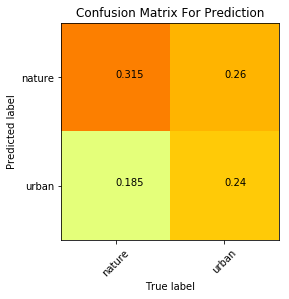

In [232]:
# confusion matrix for urban
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(merge_df['svm_prediction_train'], merge_df['labels'])

plt.clf()
classNames = ['nature', 'urban']
plt.imshow(cm, interpolation='nearest', cmap = plt.cm.Wistia)
tick_marks = np.arange(len(classNames))
plt.title("Confusion Matrix For Prediction")
plt.ylabel('Predicted label')
plt.xlabel('True label')
plt.xticks(tick_marks, classNames, rotation=45)
plt.yticks(tick_marks, classNames)
for i in range(2):
    for j in range(2):
        plt.text(j,i, round(cm[i][j] / components.shape[0], 3))

In [233]:
correct_urban = correct_df[correct_df['class'] == 'urban']
correct_nature = correct_df[correct_df['class'] == 'nature']
print("correctness for urban: {}%".format(correct_urban.shape[0] / num_split * 100))
print("correctness for nature: {}%".format(correct_nature.shape[0] / num_split * 100))

correctness for urban: 48.026315789473685%
correctness for nature: 63.00751879699248%


With RBF kernel - correctness looks promising

In [234]:
from sklearn.svm import SVC
clf_svc = SVC(kernel = 'rbf', gamma='auto')
clf_svc.fit(components, merge_df['labels']) 

SVC(C=1.0, cache_size=200, class_weight=None, coef0=0.0,
  decision_function_shape='ovr', degree=3, gamma='auto', kernel='rbf',
  max_iter=-1, probability=False, random_state=None, shrinking=True,
  tol=0.001, verbose=False)

In [235]:
rbf_prediction_train = clf_svc.predict(components)

In [238]:
merge_df['rbf_prediction_train'] = rbf_prediction_train

In [239]:
correct = merge_df['rbf_prediction_train'] == merge_df['labels']
correct_df = merge_df.loc[correct]
correct_count = correct_df.shape[0]
print("correctness: {}%".format(correct_count / components.shape[0] * 100))

correctness: 99.22932330827068%


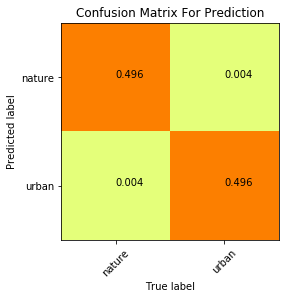

In [240]:
# confusion matrix for urban
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(merge_df['rbf_prediction_train'], merge_df['labels'])

plt.clf()
classNames = ['nature', 'urban']
plt.imshow(cm, interpolation='nearest', cmap = plt.cm.Wistia)
tick_marks = np.arange(len(classNames))
plt.title("Confusion Matrix For Prediction")
plt.ylabel('Predicted label')
plt.xlabel('True label')
plt.xticks(tick_marks, classNames, rotation=45)
plt.yticks(tick_marks, classNames)
for i in range(2):
    for j in range(2):
        plt.text(j,i, round(cm[i][j] / components.shape[0], 3))

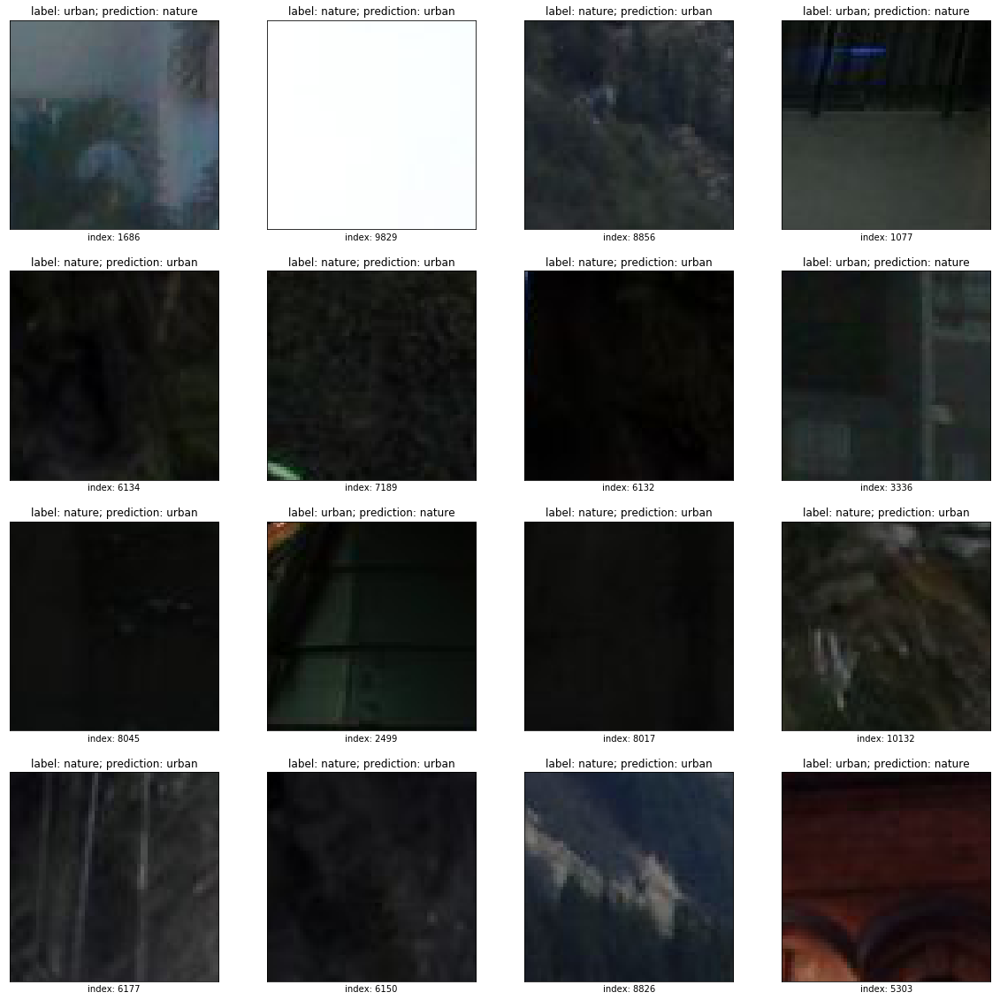

In [250]:
# some misclassification
wrong = merge_df['rbf_prediction_train'] != merge_df['labels']
wrong_df = merge_df[wrong]
wrong_indices = wrong_df.index.tolist()
img_nums = random.sample(wrong_indices, 16)
fig = plt.figure(figsize = (20, 20))
for i, raw_img_num in enumerate(img_nums):
    row = merge_df.iloc[raw_img_num]
    img_id, img_num = raw_img_num // (PROW * PCOL), raw_img_num % (PROW * PCOL)
    irow, icol = compute_patches_row_col(img_num)
    patch = patches[img_id][irow][icol]
    fig.add_subplot(4, 4, i + 1, xticks = [], yticks = [], xlabel = "index: {}".format(raw_img_num), \
                    title = 'label: {}; prediction: {}'.format(row['class'], index_to_class[row['rbf_prediction_train']]))
    plt.imshow(patch)

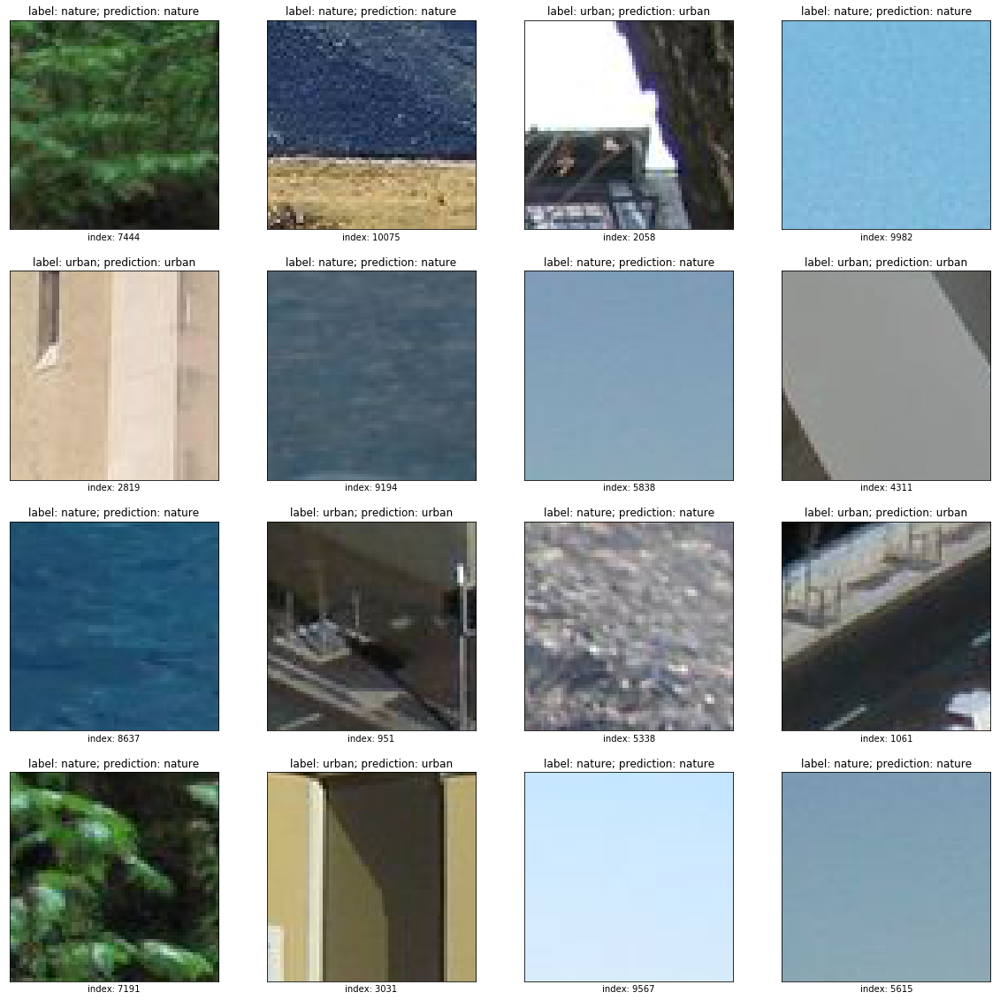

In [251]:
# some correct classification
correct_indices = correct_df.index.tolist()
correct_img_nums = random.sample(correct_indices, 16)
fig = plt.figure(figsize = (20, 20))
for i, raw_img_num in enumerate(correct_img_nums):
    row = merge_df.iloc[raw_img_num]
    img_id, img_num = raw_img_num // (PROW * PCOL), raw_img_num % (PROW * PCOL)
    irow, icol = compute_patches_row_col(img_num)
    patch = patches[img_id][irow][icol]
    fig.add_subplot(4, 4, i + 1, xticks = [], yticks = [], xlabel = "index: {}".format(raw_img_num), \
                    title = 'label: {}; prediction: {}'.format(row['class'], index_to_class[row['rbf_prediction_train']]))
    plt.imshow(patch)

In [252]:
# test on another random data set

In [253]:
random.seed(19830330)
urban_random_test, nature_random_test = sample(20)
urban_random_test = [sorted_image_to_score[ind] for ind in urban_random_test]
nature_random_test = [sorted_image_to_score[-ind] for ind in nature_random_test]

length of urban: 0, length of nature: 0
length of urban: 20, length of nature: 18
length of urban: 20, length of nature: 19


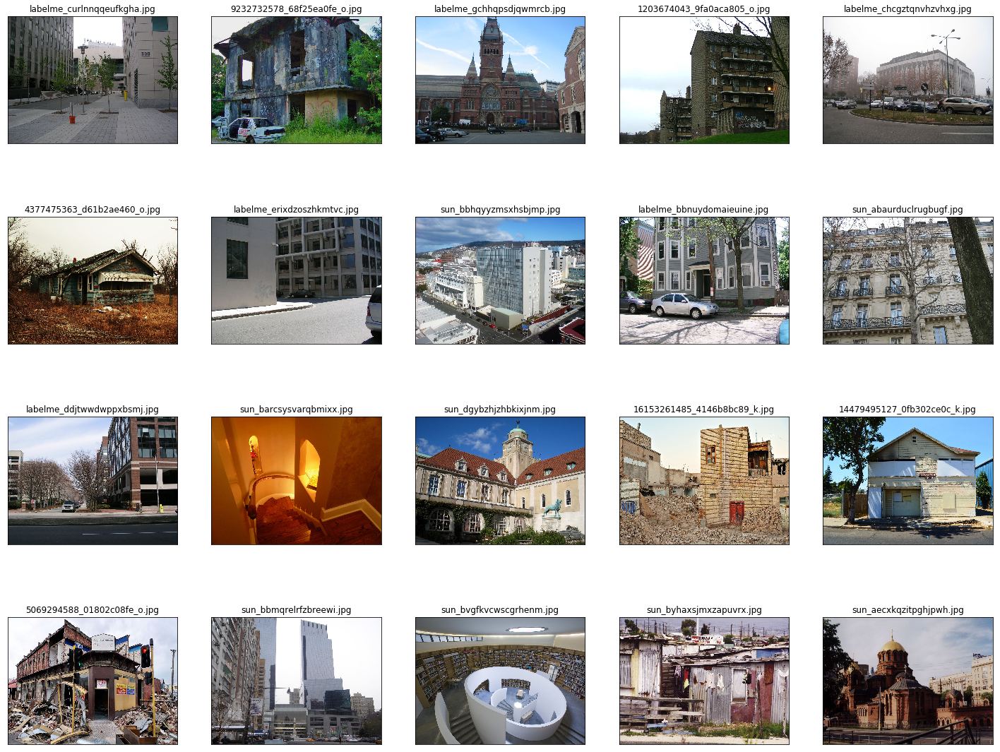

In [254]:
# visualize urban - seed = 20090930
fig = plt.figure(figsize = (25, 20))
for i, img in enumerate(urban_random_test):
    fig.add_subplot(4, 5, i + 1, yticks = [], xticks = [], title = img[1])
    img = plt.imread(os.path.join(PATH, IMAGEPATH, img[1]))
    plt.imshow(img)
plt.show()

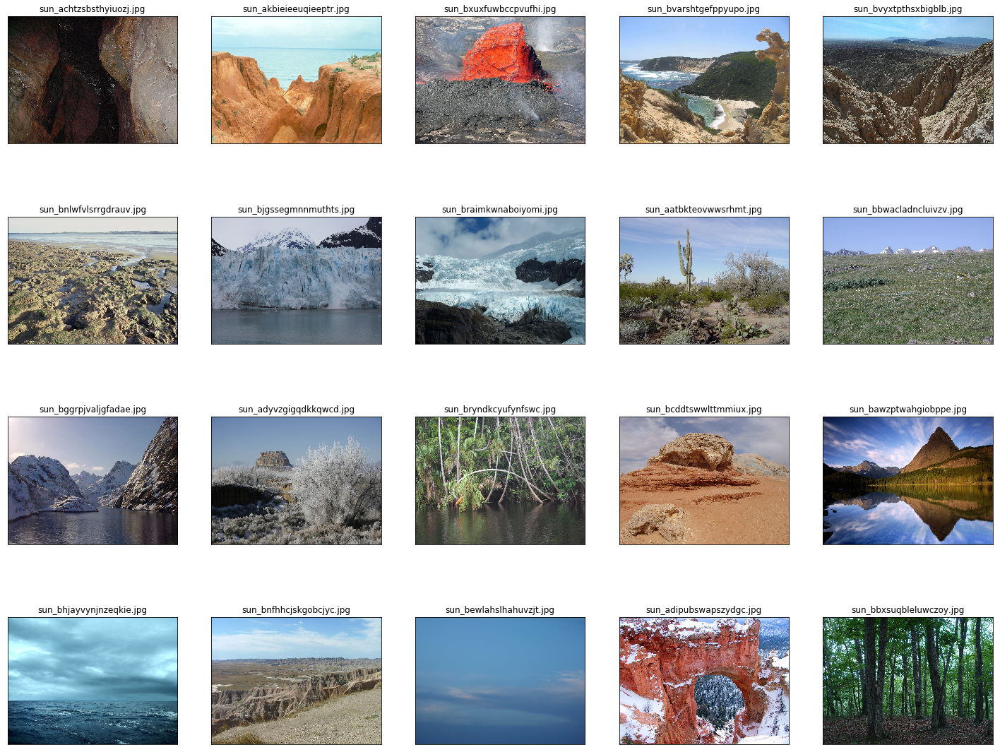

In [255]:
# visualize nature
fig = plt.figure(figsize = (25, 20))
for i, img in enumerate(nature_random_test):
    fig.add_subplot(4, 5, i + 1, yticks = [], xticks = [], title = img[1])
    img = plt.imread(os.path.join(PATH, IMAGEPATH, img[1]))
    plt.imshow(img)
plt.show()

In [275]:
# load data into Pandas DataFrame
layer = 'pool1'
grams_df_test = load_gram(handpick = [urban_random_test, nature_random_test], layer = layer, classes = ['urban', 'nature'])

# Normalize the Data (mean = 0, variance = 1)
from sklearn.preprocessing import StandardScaler
x_test = grams_df_test.loc[:, list(range(DIMS[layer]))].values # gram matrix ~ features
print(x_test.shape)
y_test = grams_df_test.loc[:, ['class']].values  # class
x_test = StandardScaler().fit_transform(x_test) # standardized features

class: urban
/scratch/midway2/canliu/grams/urban/labelme_curlnnqqeufkgha.npz
/scratch/midway2/canliu/grams/urban/9232732578_68f25ea0fe_o.npz
/scratch/midway2/canliu/grams/urban/labelme_gchhqpsdjqwmrcb.npz
/scratch/midway2/canliu/grams/urban/1203674043_9fa0aca805_o.npz
/scratch/midway2/canliu/grams/urban/labelme_chcgztqnvhzvhxg.npz
/scratch/midway2/canliu/grams/urban/4377475363_d61b2ae460_o.npz
/scratch/midway2/canliu/grams/urban/labelme_erixdzoszhkmtvc.npz
/scratch/midway2/canliu/grams/urban/sun_bbhqyyzmsxhsbjmp.npz
/scratch/midway2/canliu/grams/urban/labelme_bbnuydomaieuine.npz
/scratch/midway2/canliu/grams/urban/sun_abaurduclrugbugf.npz
/scratch/midway2/canliu/grams/urban/labelme_ddjtwwdwppxbsmj.npz
/scratch/midway2/canliu/grams/urban/sun_barcsysvarqbmixx.npz
/scratch/midway2/canliu/grams/urban/sun_dgybzhjzhbkixjnm.npz
/scratch/midway2/canliu/grams/urban/16153261485_4146b8bc89_k.npz
/scratch/midway2/canliu/grams/urban/14479495127_0fb302ce0c_k.npz
/scratch/midway2/canliu/grams/urban/5

In [257]:
# prepare patches
patches_test = [gen_patches(img[1], file_path = PATH, image_path = IMAGEPATH, stride = STRIDE, psize = PSIZE) for img in urban_random_test + nature_random_test] 

In [ ]:
# extract features
from sklearn import manifold 
IM = manifold.Isomap(n_neighbors=7, n_components=6, n_jobs=-1)
components_test = IM.fit_transform(x_test)
components_df_test = pd.DataFrame(data = components_test[:, :2], columns = ["component 1", 'component 2'])
merge_df_test = pd.concat([components_df_test, grams_df_test[['class']]], axis = 1)

In [ ]:
plot(merge_df_test, patches_test, title = "Isomap on Pool1 (20 Urban + 20 Nature)")

In [290]:
rbf_prediction_test = clf_svc.predict(components_test)

In [291]:
merge_df['rbf_prediction_test'] = rbf_prediction_test